In [46]:
import numpy as np
import pandas as pd
import os
from sklearn.manifold import TSNE
from sklearn.metrics import silhouette_score, davies_bouldin_score, pairwise_distances
%matplotlib notebook
import matplotlib.pyplot as plt
from itertools import combinations
import plotly.graph_objects as go
from plotly.subplots import make_subplots
from mpl_toolkits.mplot3d import Axes3D 
import multiprocessing
from joblib import Parallel, delayed

In [12]:
def apply_tsne(tsne, data):
    data_transformed = tsne.fit_transform(data)
    return tsne, data_transformed

In [2]:
datasets_nums = {'AGP':9511, 'ptb':3457, 't2d':1044, 'ibd':86}
color = {'AGP':'red', 'ptb':'green', 't2d':'blue', 'ibd':'yellow'}

N = sum([i for i in datasets_nums.values()])
datasets_colors = np.zeros(N).astype(str)
dataset_names = np.zeros(N).astype(str)
i_, i_prev = 0, 0
for k,v in datasets_nums.items():
    datasets_colors[i_prev:i_prev+v] = color[k]
    dataset_names[i_prev:i_prev+v] = k
    i_ += 1
    i_prev += v

# Merged

In [3]:
root_merged = './merged_datasets_proj/'
paths_merged = [os.path.join(root_merged,path) for path in os.listdir(root_merged)]
label2path = {}
datasets_merged = {}
for path in paths_merged:
    label = path.split('/')[-1].split('.')[0]
    label2path[label] = path
    datasets_merged[label] = np.genfromtxt(path, delimiter=';')

In [4]:
tsne3d = TSNE(n_components=3, init='pca', verbose=0, angle=0.3, perplexity=50, n_iter=5000, random_state=42)
results3d_merged = Parallel(n_jobs=-1)(delayed(apply_tsne)(tsne3d, data) for _, data in datasets_merged.items())  
data_transformed3d_merged = dict(zip(datasets_merged.keys(), [result[1] for result in results3d_merged]))

In [5]:
SAVE_MERGED = True

if SAVE_MERGED:
    for k,v in zip( datasets_merged.keys(), data_transformed3d_merged):
        np.save(f'./merged_datasets_transformed/{k}_tsne3d', v)

In [64]:
ls -la merged_datasets_transformed

total 23184
drwxrwxr-x  2 ibulygin ibulygin    4096 февр.  5 04:31 ./
drwxrwxr-x 17 ibulygin ibulygin    4096 февр.  5 18:27 ../
-rw-rw-r--  1 ibulygin ibulygin 2255808 февр.  3 15:43 proj_f_ae.npy
-rw-rw-r--  1 ibulygin ibulygin 2877763 февр.  4 15:37 proj_f_isomap.csv
-rw-rw-r--  1 ibulygin ibulygin 2883002 февр.  4 15:37 proj_f_lle.csv
-rw-rw-r--  1 ibulygin ibulygin  169304 февр.  5 04:31 proj_f_tsne.npy
-rw-rw-r--  1 ibulygin ibulygin 3722000 февр.  3 15:43 proj_g_ae.npy
-rw-rw-r--  1 ibulygin ibulygin 2879027 февр.  4 15:37 proj_g_isomap.csv
-rw-rw-r--  1 ibulygin ibulygin 3247965 февр.  4 15:37 proj_g_lle.csv
-rw-rw-r--  1 ibulygin ibulygin  169304 февр.  5 04:31 proj_g_tsne.npy
-rw-rw-r--  1 ibulygin ibulygin 1015184 февр.  3 15:43 proj_o_ae.npy
-rw-rw-r--  1 ibulygin ibulygin 2167181 февр.  4 15:37 proj_o_isomap.csv
-rw-rw-r--  1 ibulygin ibulygin 2157564 февр.  4 15:37 proj_o_lle.csv
-rw-rw-r--  1 ibulygin ibulygin  169304 февр.  5 04:31 proj_o_tsne.npy


In [6]:
# Initialize figure with 4 3D subplots
fig = make_subplots(
    rows=1, 
    cols=3,
    specs=[[{'type': 'scene'}, {'type': 'scene'}, {'type': 'scene'}]])

for i,(label, data_trans) in enumerate(data_transformed3d_merged.items(), start=1):

    x = data_trans[:,0] 
    y = data_trans[:,1]
    z = data_trans[:,2]
    # adding surfaces to subplots.
    fig.add_trace(
        go.Scatter3d(x=x, y=y, z=z, 
                    name=label,
                    text=dataset_names,
                     opacity=0.1, 
                     mode='markers', 
                     marker={'size':2,
                     'color':datasets_colors,
                     'line':{'width':0}}),
        row=1, 
        col=i)

fig.update_layout(
    title_text='TSNE',
    height=800,
    width=2400
)

fig.show()

<IPython.core.display.Javascript object>


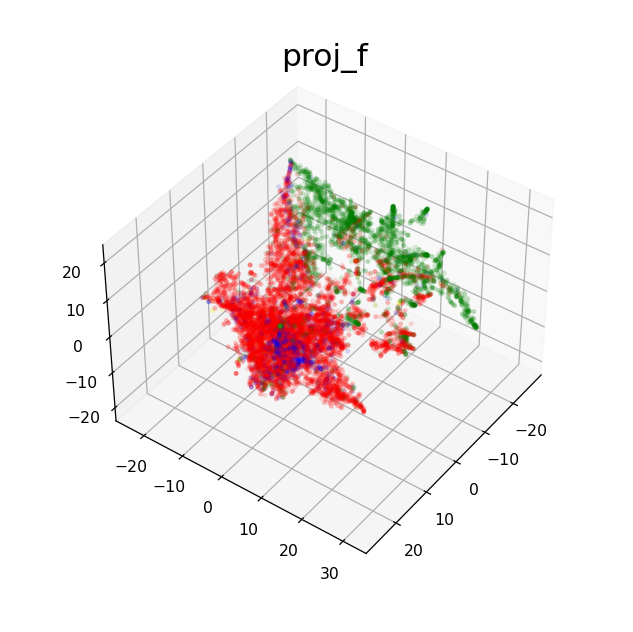

<IPython.core.display.Javascript object>


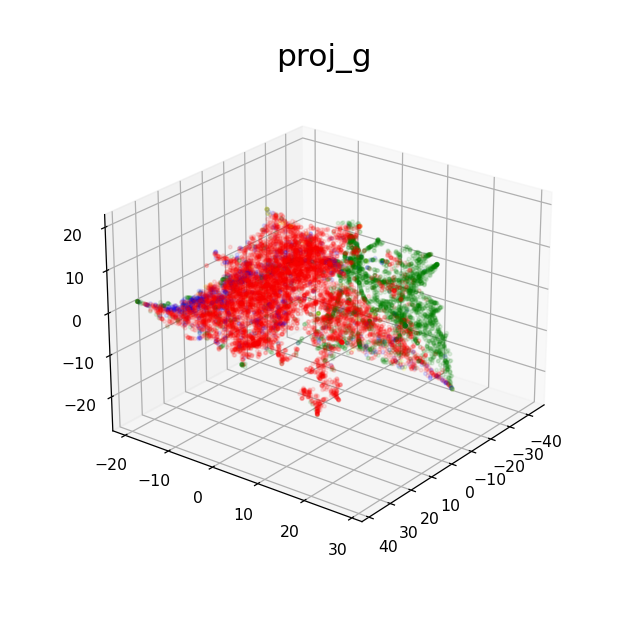

<IPython.core.display.Javascript object>


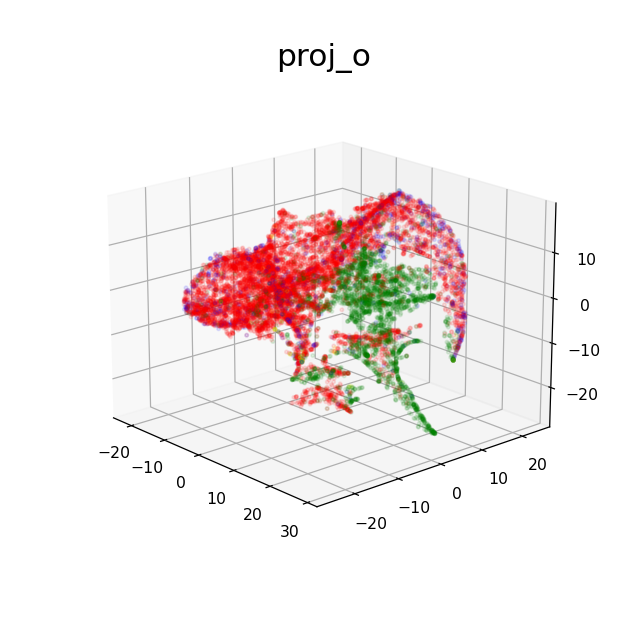

In [55]:
for i,(k,v) in enumerate(data_transformed3d_merged.items()):
    fig = plt.figure(figsize=(5,5))
    ax = fig.add_subplot(1, 1, 1, projection='3d')
    ax.scatter(v[:,0], v[:,1], v[:,2], marker='.', alpha=0.1, c=datasets_colors)
    ax.set_title(k, fontsize=20)
    plt.show()

<IPython.core.display.Javascript object>


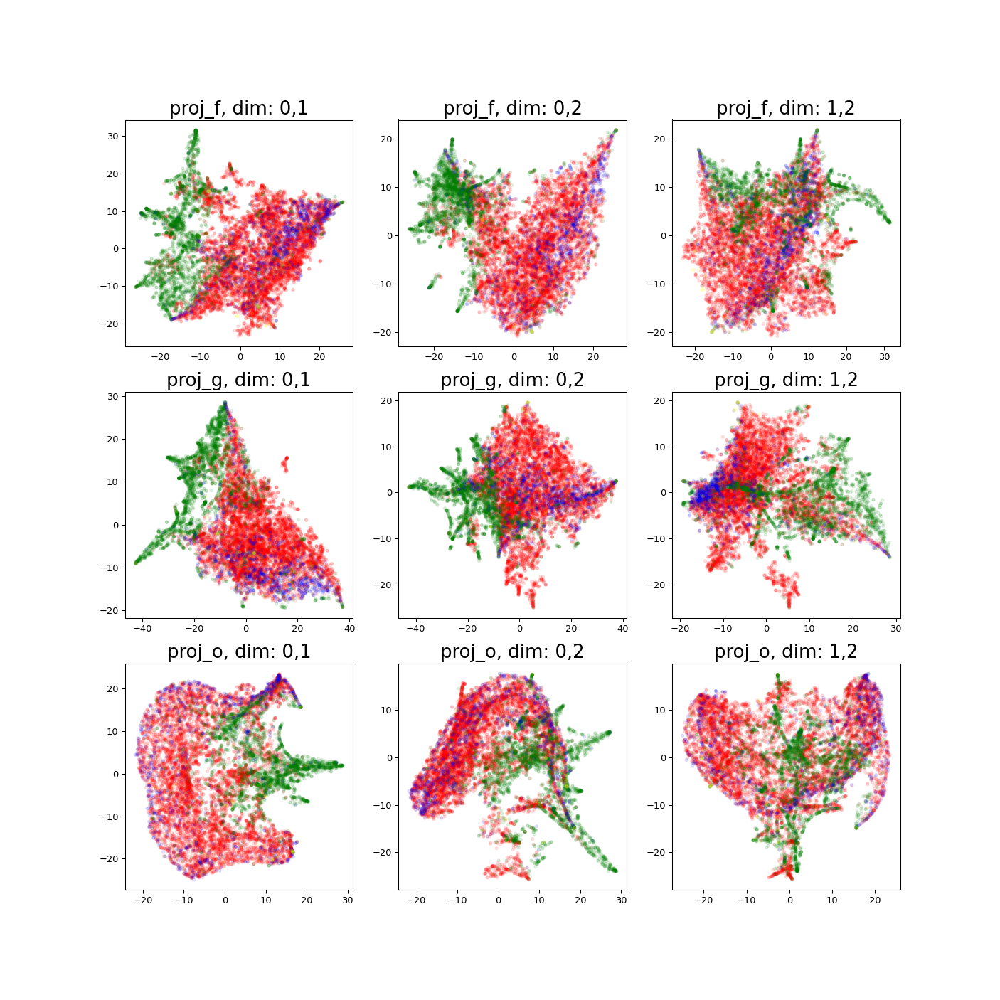

In [61]:
fig, ax = plt.subplots(ncols=3, nrows=3, figsize=(15,15))
for i,(k,v) in enumerate(data_transformed3d_merged.items()):
    for j,(d1,d2) in enumerate(combinations(range(3), 2)):
        ax[i,j].scatter(v[:,d1], v[:,d2], marker='.', alpha=0.1, c=datasets_colors)
        ax[i,j].set_title(f'{k}, dim: {d1},{d2}', fontsize=20)
#         fig.legend(color)
plt.show()

# Separate

In [8]:
root_separate = './separate_datasets_proj/'
paths_separate = [os.path.join(root_separate,path) for path in os.listdir(root_separate)]
label2path_separate = {}
datasets_separate = {}
for path in paths_separate:
    label = path.split('/')[-1].split('.')[0]
    label2path_separate[label] = path
    datasets_separate[label] = np.genfromtxt(path, delimiter=';')

In [13]:
tsne3d = TSNE(n_components=3, init='pca', verbose=0, angle=0.3, perplexity=50, n_iter=5000, random_state=42)
results3d_separate = Parallel(n_jobs=-1)(delayed(apply_tsne)(tsne3d, data) for _, data in datasets_separate.items())  

In [18]:
data_transformed3d_separate = dict(zip(datasets_separate.keys(), [result[1] for result in results3d_separate]))

In [23]:
SAVE_SEPARATE = True

if SAVE_SEPARATE:
    for k,v in data_transformed3d_separate.items():
        np.save(f'./separate_datasets_transformed/{k}_tsne3d', v)

In [28]:
fig = make_subplots(
    rows=4, 
    cols=3,
    specs=[[{'type': 'scene'}, {'type': 'scene'}, {'type': 'scene'}],
            [{'type': 'scene'}, {'type': 'scene'}, {'type': 'scene'}],
            [{'type': 'scene'}, {'type': 'scene'}, {'type': 'scene'}],
            [{'type': 'scene'}, {'type': 'scene'}, {'type': 'scene'}]])


for i,dataset_name in enumerate(['ptb', 'AGP', 't2d', 'ibd'], start=1):
    for j,tax_name in enumerate(['o', 'f', 'g'], start=1):

        label = '_'.join([dataset_name, 'proj', tax_name])
        data_trans = data_transformed3d_separate[label]
            
        x = data_trans[:,0] 
        y = data_trans[:,1]
        z = data_trans[:,2]
        # adding surfaces to subplots.
        fig.add_trace(
            go.Scatter3d(x=x, y=y, z=z, 
                        name=label,
                        text=dataset_names,
                        opacity=0.1, 
                        mode='markers', 
                        marker={'size':2,
                        'color':datasets_colors,
                        'line':{'width':0}}),
            row=i, 
            col=j)

fig.update_layout(
    title_text='TSNE',
    height=3200,
    width=2400
)

fig.show()

In [65]:
tsne2d = TSNE(n_components=2, init='pca', verbose=0, angle=0.3, perplexity=50, n_iter=5000, random_state=42)
results2d_separate = Parallel(n_jobs=-1)(delayed(apply_tsne)(tsne2d, data) for _, data in datasets_separate.items())  

In [66]:
data_transformed2d_separate = dict(zip(datasets_separate.keys(), [result[1] for result in results2d_separate]))

In [67]:
SAVE_SEPARATE = True
if SAVE_SEPARATE:
    for k,v in data_transformed2d_separate.items():
        np.save(f'./separate_datasets_transformed/{k}_tsne2d', v)

<IPython.core.display.Javascript object>


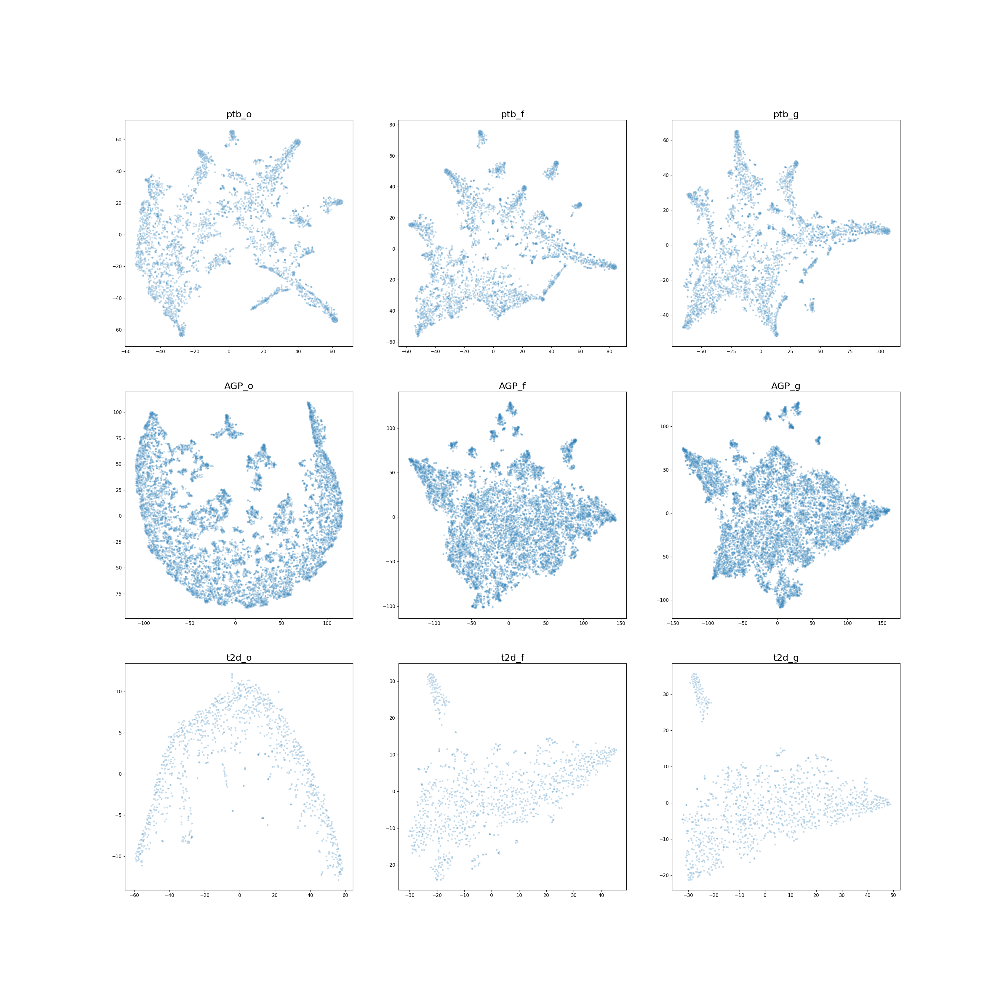

In [95]:
fig, ax = plt.subplots(ncols=3, nrows=3, figsize=(30,30))
for i,dataset_name in enumerate(['ptb', 'AGP', 't2d'], start=0):
    for j,tax_name in enumerate(['o', 'f', 'g'], start=0):
        label = '_'.join([dataset_name, 'proj', tax_name])
        v = data_transformed2d_separate[label]
        ax[i,j].scatter(v[:,0], v[:,1], marker='.', alpha=0.2)
        ax[i,j].set_title(f'{dataset_name}_{tax_name}', fontsize=20)
#         ax[j,i].axis('off')

<IPython.core.display.Javascript object>


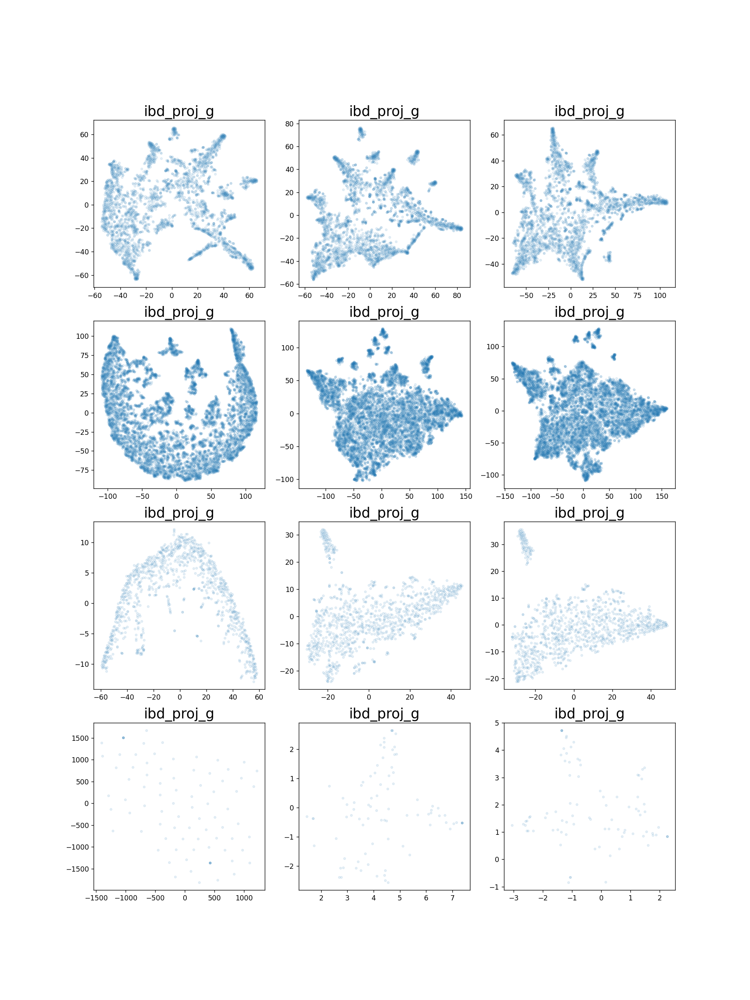

In [80]:
fig, ax = plt.subplots(ncols=, nrows=3, figsize=(15,20))
for i,dataset_name in enumerate(['ptb', 'AGP', 't2d'], start=0):
    for j,tax_name in enumerate(['o', 'f', 'g'], start=0):
        label = '_'.join([dataset_name, 'proj', tax_name])
        v = data_transformed2d_separate[label]
        ax[j,i].scatter(v[:,0], v[:,1], marker='.', alpha=0.1)
        ax[j,i].set_title(f'{k}', fontsize=20)
plt.show()